# Analyse backtests
Data is generated in `1. Perform backtest.ipynb`. This notebook analyses the backtest results

In [1]:
import pandas as pd
import numpy as np
from collections import OrderedDict
import cufflinks
cufflinks.go_offline()

import glob
import plotly.figure_factory as ff
import calculate_congestion as cc

In [5]:
# Load result files
files = glob.glob('output/2022-08-30T12-39-45/results*.csv')
files

['output/2022-08-30T12-39-45\\results_original_weather.csv',
 'output/2022-08-30T12-39-45\\results_perfect_solar.csv',
 'output/2022-08-30T12-39-45\\results_perfect_wind.csv',
 'output/2022-08-30T12-39-45\\results_perfect_wind_solar.csv']

In [41]:
# Read in the backtestdataframes
forecast_dataframes = {file.split('\\')[1][8:].split('.')[0] : pd.read_csv(file, parse_dates=True, index_col=0) for file in files}
# Add the operational forecasts
op_forc = pd.read_csv('input/prepped_inputs.csv', index_col=0, parse_dates=True).loc[:,['Day_ahead_forecast', 'Load_corrected_for_curtailment']]
# Rename to match naming convention
op_forc.columns=['forecast','realised']
forecast_dataframes.update({'operational': op_forc})

In [42]:
# Sort by name
forecast_dataframes = OrderedDict(sorted(forecast_dataframes.items()))

maes=dict()
for fname, df in forecast_dataframes.items():
    # Calculate metrics
    mae = (df['forecast']-df['realised']).abs().mean()
    maes.update({fname:mae})
kpis=pd.DataFrame(maes, index=['MAE'])

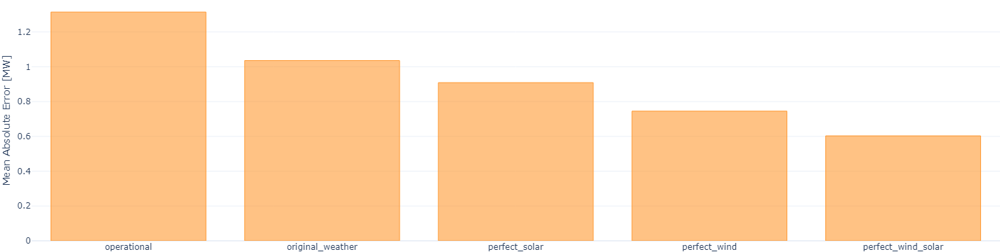

In [72]:
# Plot MAE
kpi_fig = kpis.T.iplot(kind='bar', layout=dict(template='plotly_white', width=300, height=300, margin=dict(t=0,b=0,l=0,r=0), xaxis=dict(),
                                                           yaxis=dict(title='Mean Absolute Error [MW]',
                                                                      tick0=0, dtick=0.2)), asFigure=True)
kpi_fig.show()
kpi_fig.write_image('results/figs/fig7_mae.svg')

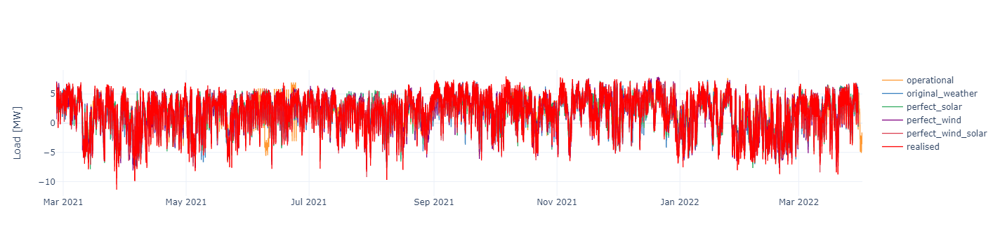

In [45]:
# plot single timeline of all dfs
plot_df = pd.DataFrame()
for name, df in forecast_dataframes.items():
    plot_df = plot_df.merge(df['forecast'].rename(name), left_index=True, right_index=True, how='outer')
plot_df = plot_df.merge(df['realised'], left_index=True, right_index=True, how='outer')
fig = plot_df.iplot(layout=dict(template='plotly_white', yaxis=dict(title='Load [MW]')), asFigure=True)
fig.update_traces(dict(line=dict(color='red')), selector=dict(name='realised'))
fig.show()

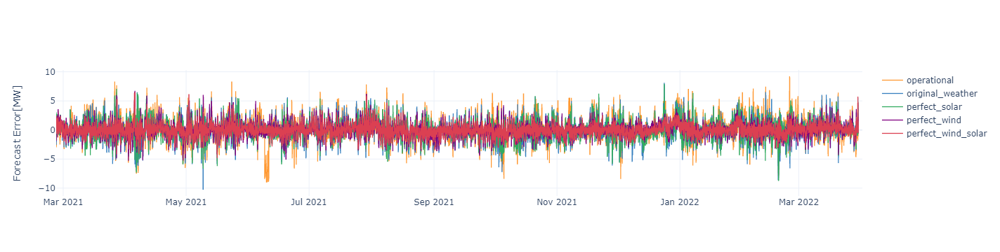

In [48]:
# Calculate & plot the residuals
err_df = plot_df.apply(lambda x: x-x.realised, axis=1).iloc[:,:-1]
err_df.iplot(layout=dict(template='plotly_white', yaxis=dict(title='Forecast Error[MW]')))

In [51]:
# Note that there is a large operational error caused by a disturbance from 2021-06-08 20:00 to 2021-06-11 03:00. (Failing of measurement device).
# Calculate to what extent the MAE is impacted -> Only a couple % (1.30 v 1.27)
print(f'non_filtered: {err_df.abs().mean()["operational"]:.2f}')
print(f'    filtered: {err_df[~err_df.index.isin(err_df["2021-06-08 20:00":"2021-06-11 03:00"].index)].abs().mean()["operational"]:.2f}')

non_filtered: 1.30
    filtered: 1.27


In [71]:
# Plot figure of pdf of errors
fig = ff.create_distplot([err_df.dropna()['original_weather'],err_df.dropna()['operational']], group_labels=['original_weather','operational'], bin_size=100, show_rug=False, show_hist=False)
fig.update_layout(dict(width=300, height=200, margin=dict(t=0,b=0,l=0,r=0), yaxis=dict(title='Probability denisty [-]'), xaxis=dict(title='Error [MW]'), template='plotly_white'), legend=dict(x=0.6, traceorder='normal'))
fig.show()
fig.write_image('results/figs/fig5_pdfs.svg')

In [104]:
## Plot detailed figure of timeseries of operational, original_weather and realised to compare periods of interest
detailed_fig = plot_df[['operational', 'original_weather', 'realised']].dropna().iplot(asFigure=True,
                                                                                       layout=dict(template='plotly_white', width=400, height=200, margin=dict(t=0,b=0,l=0,r=0)))
detailed_fig.update_traces(selector=dict(name='realised'), line=dict(color='red'))
period_1 = ['2021-06-08','2021-06-15']
period_2 = ['2021-03-19','2021-03-25']
detailed_fig.update_layout(dict(xaxis=dict(range=period_1), yaxis=dict(title='Load [MW]', range=[-9,7]), showlegend=False))

detailed_fig.write_image('output/figs/fig6a.svg')
# Repeat for second period of interest. Here, do show legend and change width accordingly
detailed_fig.update_layout(dict(xaxis=dict(range=period_2), yaxis=dict(title=None)), showlegend=True, width=450)

detailed_fig.write_image('output/figs/fig6b.svg')

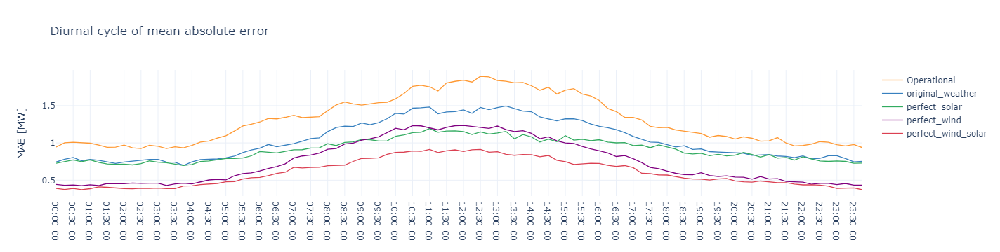

In [13]:
err_df.abs().groupby(err_df.index.time).mean().iplot(layout=dict(title='Diurnal cycle of mean absolute error', yaxis=dict(title='MAE [MW]'), xaxis=dict(), template='plotly_white', width=500, height=300))

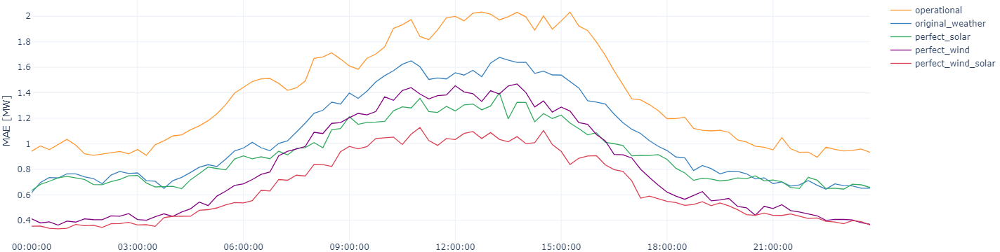

In [113]:
# Check if conclusions change when considering the summer months only -> they do not.
err_df_congestion_season = err_df[err_df.index.month.isin([4,5,6,7,8])]
diurnal_err_fig = err_df_congestion_season.abs().groupby(err_df_congestion_season.index.time).mean().iplot(layout=dict(yaxis=dict(title='MAE [MW]'),
                                                                                                                       xaxis=dict(tickvals=[0,3*4,6*4,9*4,12*4,15*4,18*4,21*4]# this is in 15min values
                                                                                                                                 ),
                                                                                                                       template='plotly_white', width=500, height=200, margin=dict(t=0,b=0,l=0,r=0)), asFigure=True)
diurnal_err_fig.show()
diurnal_err_fig.write_image('results/figs/fig8_diurnal_err.svg')


n points: 5386 n days: 349


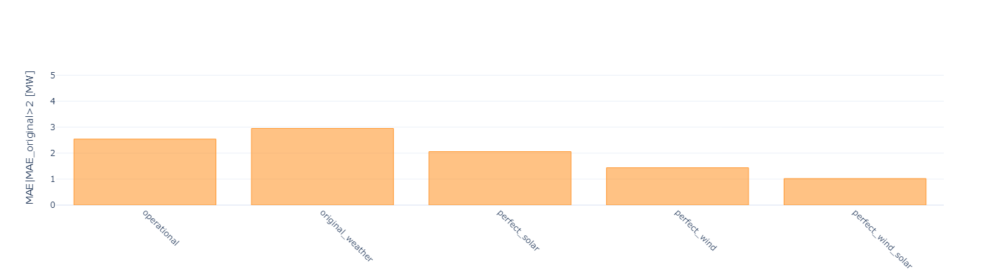

In [133]:
## Investigate conditional error reduction
section = err_df.abs()[err_df.abs()['original_weather']>2]
print(f'n points: {len(section)}',
      f'n days: {len(set(section.index.date))}')
condit_layout=dict(width=300, height=400, template='plotly_white',yaxis=dict(title='MAE [MW] | MAE_original>2'), xaxis=dict(tickangle=45))
conditional_original_fig = section.mean().iplot(kind='bar', layout=condit_layout|dict(yaxis=dict(title='MAE|MAE_original>2 [MW]', range=[0,5.2])), asFigure=True)
conditional_original_fig.show()
conditional_original_fig.write_image('output/figs/fig9a_original.svg')

n points: 53 n days: 11


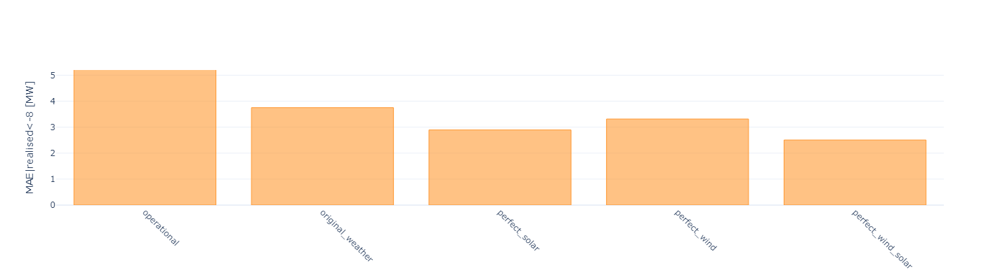

In [134]:
# Repeat, but for when the load is very low (congestion is likely)
section = err_df.abs()[plot_df.realised<-8]
print(f'n points: {len(section)}',
      f'n days: {len(set(section.index.date))}')
conditional_realised_fig = section.mean().iplot(kind='bar', layout=condit_layout|dict(yaxis=dict(title='MAE|realised<-8 [MW]', range=[0,5.2])), asFigure=True)
conditional_realised_fig.show()
conditional_realised_fig.write_image('output/figs/fig9b_realised.svg')